# Crime Situation in San Francisco and How It Effect Short Time Living with Airbnb

### Motivation

Curiosity about crime situation in San Francisco due to friends’ experience with car break-in near residential are. 
News about blast of car break-ins https://www.kqed.org/news/11643054
Spring Break Plan – short time visiting to San Francisco: I plan to visiting friend who lives in San Francisco for 4-5 days. I was going to drive there and stay in Airbnb/Expedia hotel room

### Database

The dataset 1: from Inside Airbnb (http://insideairbnb.com/get-the-data.html). The website provides data publicly available from Airbnb. it contains well-organized comprehensive data ready to be used directly for analysis purpose. Of course, I will focus on listings and reviews in San Francisco. 


The dataset 2: from SF open data(https://datasf.org/opendata/). This website provides open data from several city departments such as Citizen Complaints, Police Department and Building Inspection. So we know it is trustworthy. Also, it provides public APIs.
The dataset I’m working on now (https://data.sfgov.org/Public-Safety/Police-Department-Incidents-Current-Year-2017-/9v2m-8wqu)


### Method/Package

Data Extracting, Cleaning
Plotting : seaborn
Text Mining: WordCloud
Maps : Folium


### Read and Clean Data

In [2]:
import pandas as pd
import numpy as np
import os
import json

import folium
from folium.plugins import MarkerCluster, ScrollZoomToggler, HeatMap
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

from geopy.geocoders import Nominatim

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image

from nltk.corpus import stopwords
import string
import nltk
nltk.download('stopwords')
nltk.download('punkt')
import re

import statsmodels.stats.api as sm
from statsmodels.formula.api import ols
import statsmodels.graphics
import statsmodels.formula.api as smf

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/liliqi/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /Users/liliqi/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


/anaconda3/lib/python3.6/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [45]:
# adjust general setting
sns.set(rc={'figure.figsize':(12,10)}) # reset size of the plot to make it more clear
sns.set_context("talk")
pd.options.display.max_rows = 150 # make sure when checking large files with a stack of listing, no hidding content
# change color palettes in seaborn plots
current_palette_1 = sns.color_palette("husl", 8)
sns.set_palette(current_palette_1)

In [8]:
# look for key_on for folium package
with open('/Users/liliqi/Desktop/Current Police Districts.geojson') as f:
    data = json.load(f)
    
data['features']

[{'geometry': {'coordinates': [[[[-122.39186138812263, 37.79424680970543],
      [-122.39178965045961, 37.7941712252344],
      [-122.39173396937666, 37.794202997266886],
      [-122.39166681055336, 37.794132183335286],
      [-122.39172264479394, 37.79410052824544],
      [-122.3916726266299, 37.79404791882388],
      [-122.39198184041989, 37.79387175411522],
      [-122.39158906053727, 37.7935276602537],
      [-122.391723729351, 37.79342884992162],
      [-122.39081210865645, 37.79266254752923],
      [-122.38929874837604, 37.791390503319754],
      [-122.38880784444565, 37.790977844242896],
      [-122.38893019202212, 37.790880005297964],
      [-122.38861191205169, 37.790313282442106],
      [-122.38804942461617, 37.790507681830064],
      [-122.38801188242846, 37.79043150367101],
      [-122.38836945137388, 37.79030798560057],
      [-122.38828685042859, 37.79016135313995],
      [-122.3883208318677, 37.79015067506812],
      [-122.3882437252264, 37.790007412063964],
      [-122.

In [9]:
df_crime = pd.read_csv('/Users/liliqi/Desktop/Police_Department_Incidents_-_Current_Year__2017_.csv', sep = ',')
df_crime.dropna(axis=0, how = 'any') # drop NA
df_crime.head()

,IncidntNum,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,Location,PdId
0,170848380,ARSON,ARSON OF A VEHICLE,Tuesday,10/17/2017,01:26,BAYVIEW,NONE,NORTHRIDGE RD / HARBOR RD,-122.377002,37.731011,"(37.731010976896, -122.37700207993551)",17084838026031
1,170850971,LARCENY/THEFT,GRAND THEFT PICKPOCKET,Tuesday,10/17/2017,19:15,SOUTHERN,NONE,7TH ST / MARKET ST,-122.412515,37.780478,"(37.78047774805081, -122.41251534135559)",17085097106112
2,170124334,NON-CRIMINAL,FOUND PROPERTY,Monday,02/13/2017,07:20,CENTRAL,NONE,700 Block of VALLEJO ST,-122.409792,37.798508,"(37.79850834804346, -122.40979166229266)",17012433472000
3,141034403,NON-CRIMINAL,COURTESY REPORT,Thursday,12/07/2017,09:30,CENTRAL,NONE,700 Block of VALLEJO ST,-122.409792,37.798508,"(37.79850834804346, -122.40979166229266)",14103440368030
4,141034403,NON-CRIMINAL,LOST PROPERTY,Thursday,12/07/2017,09:30,CENTRAL,NONE,700 Block of VALLEJO ST,-122.409792,37.798508,"(37.79850834804346, -122.40979166229266)",14103440371000


In [10]:
pd.unique(df_crime['Category'])  # show the unique value of each crime type

array(['ARSON', 'LARCENY/THEFT', 'NON-CRIMINAL', 'ASSAULT', 'WARRANTS',
       'WEAPON LAWS', 'MISSING PERSON', 'OTHER OFFENSES', 'DRUG/NARCOTIC',
       'VANDALISM', 'FORGERY/COUNTERFEITING', 'STOLEN PROPERTY',
       'VEHICLE THEFT', 'BURGLARY', 'SUSPICIOUS OCC', 'RECOVERED VEHICLE',
       'FRAUD', 'TRESPASS', 'SECONDARY CODES', 'ROBBERY', 'SUICIDE',
       'DRUNKENNESS', 'BRIBERY', 'SEX OFFENSES, FORCIBLE', 'EMBEZZLEMENT',
       'PROSTITUTION', 'RUNAWAY', 'KIDNAPPING', 'LIQUOR LAWS',
       'DRIVING UNDER THE INFLUENCE', 'DISORDERLY CONDUCT', 'EXTORTION',
       'FAMILY OFFENSES', 'LOITERING', 'SEX OFFENSES, NON FORCIBLE',
       'BAD CHECKS', 'TREA', 'GAMBLING', 'PORNOGRAPHY/OBSCENE MAT'],
      dtype=object)

After observation, there is no incident category same as or similar to "car break_in". Then, after checking the description of value of "Descript" for some categories, as well as the definition on San Francisco Police Department Website, it seems that "car break_in" are classified as 'LARCENY/THEFT'. Below is the link to the San Francisco Police Department:
https://sanfranciscopolice.org/crime-reports-can-be-filed-online#vehicle-burglary

Regarding 'Non-criminal' incident, it usually includes car trouble assists, domestic(Argument between related parties where no intervention is required or injury has occurred), fire alarm, lost property, trespass warning and so on. https://hilo.hawaii.edu/security/CaseDescriptions.php
Thus, I still choose to keep this category as some incidents included are still worth attention.

### Text Mining

In [11]:
def split_words(row):
    """
    Split words in description and return words in a dataframe with article information
    row: a row of a dataframe
    """
    text = row[3]
    text = text.lower()    
    for i in string.punctuation:        
        text = text.replace(i,"")   # eliminate all the punctuation in the description
    word = text.split()
    
    df = pd.DataFrame({'word': word})
    df['IncidntNum'] = row[1]
    
    return df

In [12]:
# Seperate car break-ins from 'LARCENY/THEFT' category, based on analysis of the description of each incident
df_theft = df_crime.query('Category == "LARCENY/THEFT"') 
df_theft.reset_index(inplace = True)

# split word by word each incident
rows_2 = df_theft.shape[0]
word_frame_2 = pd.concat([split_words(df_theft.loc[i]) for i in range(0, rows_2)])

In [13]:
word_frame_2.head()

,word,IncidntNum
0,grand,170850971
1,theft,170850971
2,pickpocket,170850971
0,grand,170060164
1,theft,170060164


In [14]:
stop = set(stopwords.words('english'))

words_2 = pd.DataFrame(word_frame_2['word'].value_counts())
words_2.reset_index(inplace = True)
words_2 = words_2.rename(columns={"word": "count", "index": "word_2"})[['count', 'word_2']]
words_2 = words_2.loc[[w not in stop for w in words_2.word_2], :]    # eliminate stopwords in the description

In [15]:
words_2

,count,word_2
0,47631,theft
2,32232,grand
3,30727,auto
4,27709,locked
5,14551,petty
7,7963,property
8,3322,unlocked
10,2912,building
11,2351,shoplifting
12,1320,person


We can see two words relate to car break-ins, "vehicle" and "auto". Other words like "motorcycle" and "boat" may not be appropriate to use along with "break-ins". Thus, they are excluded.

In [16]:
word_vehicle_2 = word_frame_2.query('word == "vehicle"')
word_vehicle_2.reset_index(inplace = True)
word_vehicle_2 = word_vehicle_2.drop(columns=['index'])

df_crime = df_crime.join(word_vehicle_2.set_index('IncidntNum'), on='IncidntNum') 

Now, new column "word" with "vehicle" value represent the row is "car break-in" category.
There're nas filling out the blanks of "word", where incidents are not "car break-in" category, but it does not matter. We will utilize that in further study

In [17]:
pd.unique(df_crime[df_crime.word == "vehicle"]["Descript"])

array(['ATTEMPTED THEFT FROM LOCKED VEHICLE',
       'GRAND THEFT FROM LOCKED AUTO',
       'ATTEMPTED THEFT FROM UNLOCKED VEHICLE',
       'MALICIOUS MISCHIEF, VANDALISM OF VEHICLES',
       'ROBBERY ON THE STREET WITH A DANGEROUS WEAPON',
       'AGGRAVATED ASSAULT WITH A DEADLY WEAPON',
       'STOLEN PROPERTY, POSSESSION WITH KNOWLEDGE, RECEIVING',
       'POSSESSION OF BURGLARY TOOLS', 'DANGER OF LEADING IMMORAL LIFE',
       'HABITUAL TRUANT', 'TRAFFIC COLLISION, HIT & RUN, PROPERTY DAMAGE',
       'LOST PROPERTY', 'MALICIOUS MISCHIEF, VANDALISM',
       'INVESTIGATIVE DETENTION', 'TAMPERING WITH A VEHICLE',
       'PROBATION VIOLATION', 'BURGLARY OF RESIDENCE, UNLAWFUL ENTRY',
       'BURGLARY, UNLAWFUL ENTRY', 'PAROLE VIOLATION', 'CONSPIRACY',
       'FALSE EVIDENCE OF VEHICLE REGISTRATION',
       'PETTY THEFT FROM LOCKED AUTO', 'PETTY THEFT OF PROPERTY',
       'GRAND THEFT OF PROPERTY', 'MALICIOUS MISCHIEF, BREAKING WINDOWS',
       'ENROUTE TO OUTSIDE JURISDICTION',
       

After observing, I realized that one incident could have several rows with multiple descriptions. For instance, someone got his/her car window smashed and his/her bag stolen from the car. The descriptions might consist of 'GRAND THEFT FROM LOCKED AUTO', 'LOST PROPERTY', 'MALICIOUS MISCHIEF, VANDALISM' and etc.

Hence, I choose to select "car break-in" type of crime based on four target descriptions: 'ATTEMPTED THEFT FROM LOCKED VEHICLE', 'ATTEMPTED THEFT FROM UNLOCKED VEHICLE', 'GRAND THEFT FROM LOCKED AUTO' and 'PETTY THEFT FROM LOCKED AUTO'. Once an incident has such description, it counts for "car break-in" no matter what other descriptions it has.

In [18]:
car_des = set(['ATTEMPTED THEFT FROM LOCKED VEHICLE', 'ATTEMPTED THEFT FROM UNLOCKED VEHICLE', 
               'PETTY THEFT FROM LOCKED AUTO', 'GRAND THEFT FROM LOCKED AUTO'])

df_crime_car = df_crime.copy()
df_crime_car.loc[[l in car_des for l in df_crime_car.Descript], 'Category'] = "CAR_BREAK-IN"

df_type = df_crime_car.groupby('Category')['IncidntNum'].nunique() # make sure only count unique incident once
df_type = pd.DataFrame({'crime_type':df_type.index, 'count':df_type.values})
df_type = df_type.sort_values(by = 'count', ascending = [0])
df_type.reset_index(inplace = True)

In [19]:
df_type.head(10)

,index,count,crime_type
0,5,27567,CAR_BREAK-IN
1,17,19709,LARCENY/THEFT
2,21,17044,NON-CRIMINAL
3,22,14981,OTHER OFFENSES
4,1,11462,ASSAULT
5,36,9583,VANDALISM
6,33,5992,SUSPICIOUS OCC
7,4,5629,BURGLARY
8,37,5294,VEHICLE THEFT
9,38,4623,WARRANTS


### Comparing Different Categories of Crime 

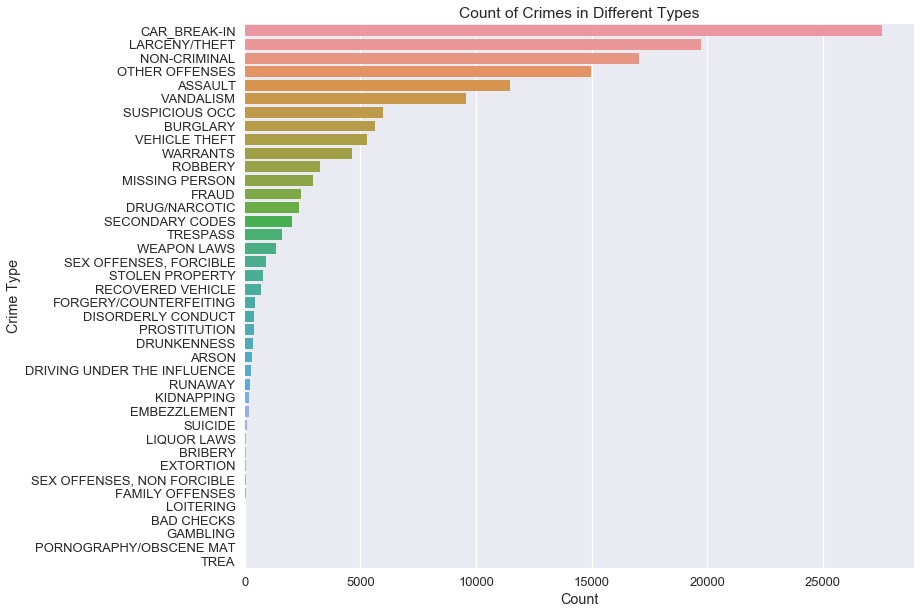

In [46]:
sns.barplot('count', 'crime_type', data = df_type)
plt.title('Count of Crimes in Different Types')
plt.xlabel('Count')
plt.ylabel('Crime Type')
plt.show()

The outcome is shocking! As "car break-in" was originally counted as "LARCENY/THEFT", it seems that more than half of the crimea categorized as "LARCENY/THEFT" are car break-ins. No wonder we could see that there's a blowout of news about such incident recently. 

Overall, car break-in is the number one incident happens in San Francisco, over 27000 such incidents happened last year, followed by another huge issue of general theft, with a number of almost 20000 occurence. Other than that, some non-severe incidents happened a lot as well, such as "NON-CRIMINAL", "OTHER OFFENSES" and "ASSAULT".

Also, I was kind of surprised to see that there're not many cases about drug and narcotic usage, less than 2500 cases. While number of drunkness incidents is even smaller. Due to San Francisco's reputation as a party city, this result is out of my mind.

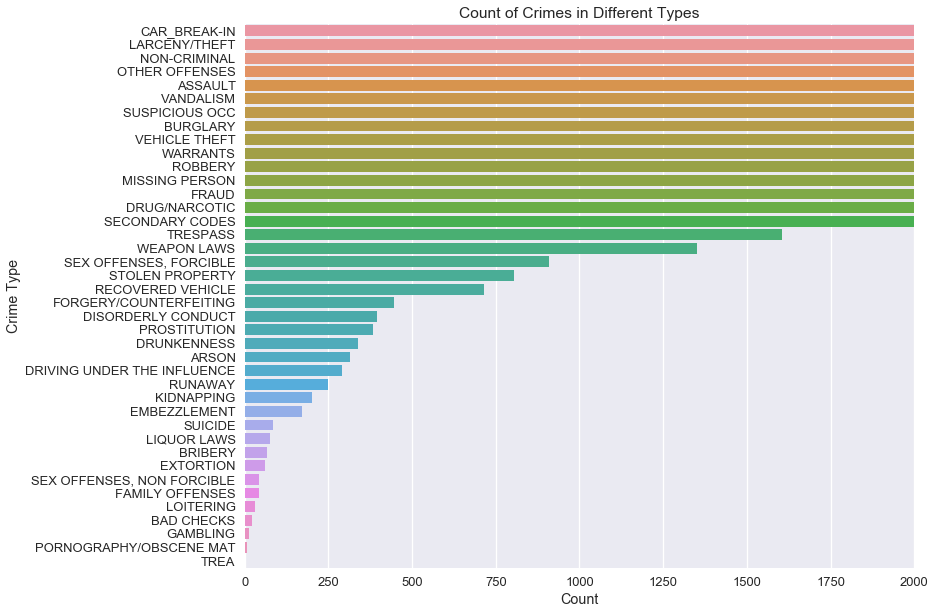

In [47]:
sns.barplot('count', 'crime_type', data = df_type)
plt.title('Count of Crimes in Different Types')
plt.xlabel('Count')
plt.ylabel('Crime Type')
plt.xlim(0, 2000)
plt.show()

Then, let's take a closer look at those incidents happened less than 2000 times. Drunkness occurence is indeed pretty low, just a little bit above 250 times. Something to worry about is that over 1250 cases took place in 2017 was about breaking the weapon law. The number is 5 times as that of people getting drunk! Related to the increasing number of shooting crime, I suppose we do need to take gun banning into consideration. Moreover, things like "arson" and "KIDNAPPING" happened just a little less than drunkness, which is not a good sign.

### Word Cloud of High Frequency Words In Description of Car Break-in Incidents

/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:742: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


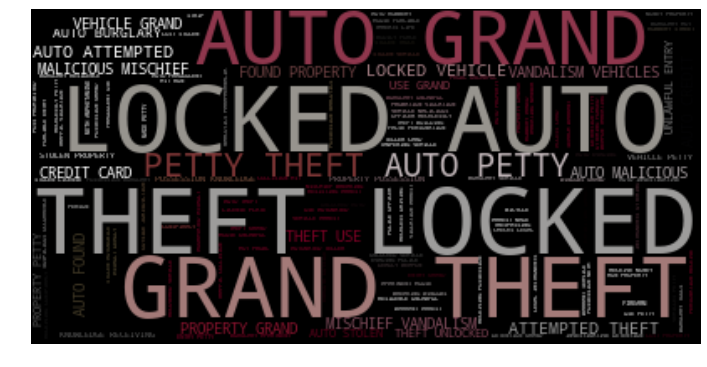

In [22]:
car_id = df_crime_car[df_crime_car.Category == "CAR_BREAK-IN"]['IncidntNum']
df_word_car = df_crime_car.loc[[l in car_id.values for l in df_crime_car.IncidntNum], :]

description = df_word_car.dropna(subset = ['Descript'])
words = str.join(' ', description.Descript)

f = open('description.txt','w')
f.write(words)

logo = np.array(Image.open("/Users/liliqi/Desktop/sf_logo.jpg"))
image_colors = ImageColorGenerator(logo)

text = open('description.txt').read()
wc = WordCloud(stopwords = stop).generate(text)
plt.imshow(wc.recolor(color_func = image_colors), interpolation = 'bilinear')
plt.axis("off")
plt.show()

As we already expect that words like "GRAND", "AUTO", "LOCKED", "THEFT" and "PETTY" are frequently used will appear with larger size. In the graph, the bigger the words, the higher frequentcy it has. I then try another word cloud without all the predictable words.

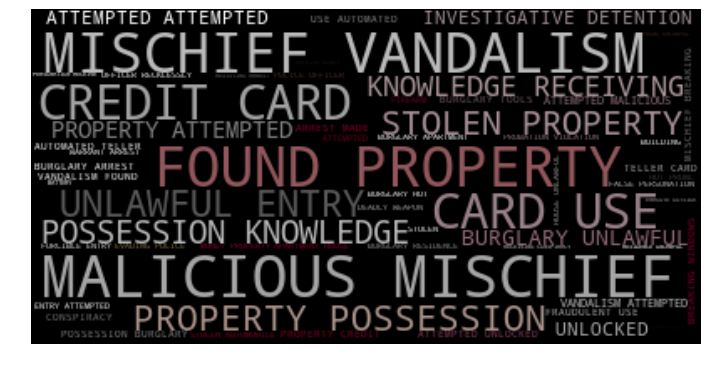

In [23]:
stop_2 = set(stopwords.words('english'))
stop_2.update(["THEFT", "LOCKED", "PETTY", "AUTO", "VEHICLE", "VEHICLES", "GRAND",]) 

wc_2 = WordCloud(stopwords = stop_2).generate(text)
plt.imshow(wc_2.recolor(color_func = image_colors), interpolation = 'bilinear')
plt.axis("off")
plt.show()

Now we could see words like "MALICIOUS", "MISCHIEF", "VANDALISM" and "CREDIT CARD". It seems that a large scale of car break-ins involve severe damage to the cars. One common example is smashed windows. Also, thieves might tend to break into a car if they've seen a credit card inside. Or we could say they usually take credit cards instead of others.

### Map the Number of Crimes Reported Per District

In [24]:
df_car_district = df_word_car.groupby('PdDistrict')['IncidntNum'].nunique()
df_car_district = pd.DataFrame({'PdDistrict':df_car_district.index, 'Count':df_car_district.values})
df_car_district = df_car_district.sort_values(by = 'Count', ascending = [0])

df_crime_district = df_crime_car.groupby('PdDistrict')['IncidntNum'].nunique()
df_crime_district = pd.DataFrame({'PdDistrict':df_crime_district.index, 'Count':df_crime_district.values})
df_crime_district = df_crime_district.sort_values(by = 'Count', ascending = [0])

In [25]:
df_car_district

,Count,PdDistrict
4,6032,NORTHERN
7,5133,SOUTHERN
1,5114,CENTRAL
3,2620,MISSION
6,2455,RICHMOND
0,1633,BAYVIEW
5,1514,PARK
8,1419,TARAVAL
2,1091,INGLESIDE
9,556,TENDERLOIN


In [26]:
df_crime_district

,Count,PdDistrict
7,22741,SOUTHERN
4,17022,NORTHERN
3,16654,MISSION
1,15521,CENTRAL
0,10674,BAYVIEW
8,9190,TARAVAL
2,8527,INGLESIDE
6,7593,RICHMOND
5,6783,PARK
9,6285,TENDERLOIN


In [27]:
df_car_marker = df_word_car.drop_duplicates(subset = ['IncidntNum'], keep='first')

car_marker = df_car_marker[['X', 'Y', 'DayOfWeek', 'Time', 'Date', 'Resolution']]
car_marker.reset_index(inplace = True)

In [29]:
car_marker

,index,X,Y,DayOfWeek,Time,Date,Resolution
0,10,-122.417634,37.787063,Sunday,04:00,01/22/2017,NONE
1,11,-122.446913,37.803283,Monday,12:20,01/23/2017,NONE
2,13,-122.443285,37.713618,Tuesday,17:00,01/31/2017,NONE
3,22,-122.401433,37.800457,Wednesday,18:00,03/01/2017,NONE
4,32,-122.392761,37.787408,Monday,21:40,04/03/2017,NONE
5,67,-122.429819,37.725460,Wednesday,22:00,03/15/2017,NONE
6,69,-122.454330,37.768153,Sunday,14:00,02/05/2017,NONE
7,76,-122.406338,37.753004,Sunday,18:43,02/05/2017,NONE
8,91,-122.425643,37.790431,Friday,14:45,02/17/2017,NONE
9,95,-122.403405,37.775421,Monday,10:30,02/06/2017,NONE


In [30]:
SF_COORDINATES = (37.7749, -122.4194)
my_friend = [37.798907, -122.406042]

district_geo = '/Users/liliqi/Desktop/Current Police Districts.geojson'

In [31]:
"""This function take the dataframe_1 to map with layer per police department discrict, 
   and dataframe_2 to map each row as a marker. The string in input will be displayed in the legend name.
   While the number in input will change the information of pop out when you click."""
 
def district_map_making(dataframe_1, dataframe_2, string, num):
    map2 = folium.Map(location = SF_COORDINATES, zoom_start = 12)
    map2.choropleth(
        geo_data = district_geo, 
        data = dataframe_1, 
        columns=['PdDistrict', 'Count'], 
        key_on = 'feature.properties.district', 
        # threshold_scale = [0, 200, 300, 400, 500, 1000],
        fill_color = 'YlGnBu', 
        fill_opacity = 0.7, 
        line_opacity = 0.4, 
        legend_name = 'Number of ' + string + ' Reported Per District'
    )

    folium.Marker(
        location = my_friend,
        popup = 'My friend is here!',
        icon = folium.Icon(color = 'green', icon = 'info-sign')
    ).add_to(map2)

    # I wish to limit the driving time to around 20 mins from my place to my friend's house.
    # Thus, set the radius here equal to 5000 meters.
    folium.features.Circle(
        radius = 5000,
        location = my_friend,
        popup = "5km Circle",
        color = 'crimson',
        fill = False,
    ).add_to(map2)
    
    marker_cluster = folium.plugins.MarkerCluster(name = string + " layer").add_to(map2)

    for each in dataframe_2.iterrows():
        folium.Marker(location = list((each[1][2], each[1][1])), icon = folium.Icon(color = 'red', icon = 'exclamation-sign'),
                     popup = str(each[1][num])).add_to(marker_cluster)

    

    toggler = ScrollZoomToggler().add_to(map2) # Creates a button for enabling/disabling scroll on the Map.
    
    return(map2)

In [ ]:
district_map_making(df_car_district, car_marker, "Car Break-ins", 3)

In [ ]:
district_map_making(df_car_district, car_marker, "Car Break-ins", 5)

As my friend live in a place near near China Town and Financial District, where house rent tend to be cheaper, and population tend to be more mixed, it is not surprice that this area is less safer than others. 

Regarding police department district, we can see that Northern District is the worst, and Southern District and Central District are not safe for parking as well. While Ingleside District and Tenderloin District are much safer. On the map, it reveals that north-east cornor of San Francisco is the worst. Then, as we go south-west dirsction, the city tend to be safer.

It is kind of interesting that Tenderloin District are surround by districts with most occurence of car break-ins and it has the least occurence of such incidents. However, it could be the reason that it is the smallest district. Hence, it does not have much population at the first place. It could be normal that it carries the smalllest number of car break-in incedents. 

As I draw a circle of radius of 5km, since I wish to live within 20 mins driving from my friend. Hence, we could see that I'd better choose place to live between Mission District, Richmond District, Bayview District and Park District.

Take a close look, we could see that right at the street block of my friend's house, 6 incidents happened last year. By the China Twon area, there are in total over 500 cars got break-in. Union Square is also not safe, even though it is always crowded. Nonetheless, area near the Golden Park is dangerous as well, over 1500 incidents happeded nearby.

### Airbnb Dataset

In [32]:
df = pd.read_csv('/Users/liliqi/Desktop/listings.csv', sep = ',')
df.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,958,https://www.airbnb.com/rooms/958,20180303203625,2018-03-04,"Bright, Modern Garden Unit - 1BR/1B",Our bright garden unit overlooks a grassy back...,"Newly remodeled, modern, and bright garden uni...",Our bright garden unit overlooks a grassy back...,none,*Quiet cul de sac in friendly neighborhood *St...,...,t,STR-0001256,"{""SAN FRANCISCO""}",f,f,moderate,f,f,1,1.21
1,5858,https://www.airbnb.com/rooms/5858,20180303203625,2018-03-04,Creative Sanctuary,NaN,We live in a large Victorian house on a quiet ...,We live in a large Victorian house on a quiet ...,none,I love how our neighborhood feels quiet but is...,...,t,NaN,"{""SAN FRANCISCO""}",f,f,strict,f,f,1,1.04
2,7918,https://www.airbnb.com/rooms/7918,20180303203625,2018-03-04,A Friendly Room - UCSF/USF - San Francisco,Nice and good public transportation. 7 minute...,Room rental-sunny view room/sink/Wi Fi (inner ...,Nice and good public transportation. 7 minute...,none,"Shopping old town, restaurants, McDonald, Whol...",...,t,NaN,"{""SAN FRANCISCO""}",f,f,strict,f,f,7,0.16
3,8014,https://www.airbnb.com/rooms/8014,20180303203625,2018-03-04,Newly Remodeled room in big house WIFI market,Freshly painted newly done laminate floor with...,The room is recently painted in the color of c...,Freshly painted newly done laminate floor with...,none,"The neighborhood is very residential, close to...",...,t,STR-0000974,"{""SAN FRANCISCO""}",t,f,moderate,f,f,3,1.12
4,8142,https://www.airbnb.com/rooms/8142,20180303203625,2018-03-04,Friendly Room Apt. Style -UCSF/USF - San Franc...,Nice and good public transportation. 7 minute...,Room rental Sunny view Rm/Wi-Fi/TV/sink/large ...,Nice and good public transportation. 7 minute...,none,NaN,...,t,NaN,"{""SAN FRANCISCO""}",f,f,strict,f,f,7,0.16


In [33]:
df.dtypes

id                                    int64
listing_url                          object
scrape_id                             int64
last_scraped                         object
name                                 object
summary                              object
space                                object
description                          object
experiences_offered                  object
neighborhood_overview                object
notes                                object
transit                              object
access                               object
interaction                          object
house_rules                          object
thumbnail_url                       float64
medium_url                          float64
picture_url                          object
xl_picture_url                      float64
host_id                               int64
host_url                             object
host_name                            object
host_since                      

In [34]:
## Modify the data set for machine learning
df['occupied_percent'] = (365 - df['availability_365'])/ 365 * 100 

def isType(entry, type_want):
    """The function change original variabel into a dummy variable specifying if a statement is right
    argument: tf is a chatacter specifying true or false
    output is a interger """
    if (entry == type_want):
        return 1 
    else:
        return 0

def changeAmenity(entry):
    entry = str(entry)
    entry = entry.strip('{')
    entry = entry.strip('}')
    entry= entry.strip('')
    ame_list = entry.split(',')
    ame_list_new = [[i.strip('"') for i in ame_list]]
    return ame_list_new
    
df['host_is_superhost'] = [isType(i, 't') for i in df['host_is_superhost']]
df['host_has_profile_pic'] = [isType(i, 't') for i in df['host_has_profile_pic']]
df['host_identity_verified'] = [isType(i, 't') for i in df['host_identity_verified']]
df['instant_bookable'] = [isType(i, 't') for i in df['instant_bookable']]

## Here, they turn the string variables with percentage mark into numeric variable
df['host_response_rate'] = [ float(str(i).strip('%')) for i in df['host_response_rate']]
df['host_acceptance_rate'] = [ float(str(i).strip('%')) for i in df['host_acceptance_rate']]

## numpy.nan_to_num:
## Replace nan with zero and inf with finite numbers.
## Returns an array or scalar replacing Not a Number (NaN) with zero, (positive) infinity with a very large number and negative infinity with a very small (or negative) number.
df['cleaning_fee'] = np.nan_to_num(df['cleaning_fee'])
df['security_deposit'] = np.nan_to_num(df['security_deposit'])

df['cleaning_fee'] = df['cleaning_fee'].str.replace(',', '')
df['cleaning_fee'] = df['cleaning_fee'].str.replace('$', '')
df['cleaning_fee'] = df['cleaning_fee'].astype(float)

df['security_deposit'] = df['security_deposit'].str.replace(',', '')
df['security_deposit'] = df['security_deposit'].str.replace('$', '')
df['security_deposit'] = df['security_deposit'].astype(float)

df['price'] = df['price'].str.replace(',', '')
df['price'] = df['price'].str.replace('$', '')
df['price'] = df['price'].astype(float)
df['price'].head()

0    170.0
1    235.0
2     65.0
3     60.0
4     65.0
Name: price, dtype: float64

In [55]:
price = pd.DataFrame(df.groupby('neighbourhood_cleansed')['price'].mean())
price = price.sort_values(by = 'price', ascending = [1])
price.reset_index(inplace=True)
price.head()

,neighbourhood_cleansed,price
0,Crocker Amazon,88.742857
1,Lakeshore,96.500000
2,Presidio,105.000000
3,Excelsior,114.333333
4,Visitacion Valley,122.826087


In [57]:
price.tail()

,neighbourhood_cleansed,price
31,Marina,324.942623
32,Nob Hill,327.157480
33,Russian Hill,364.970874
34,Presidio Heights,419.000000
35,Seacliff,1059.111111


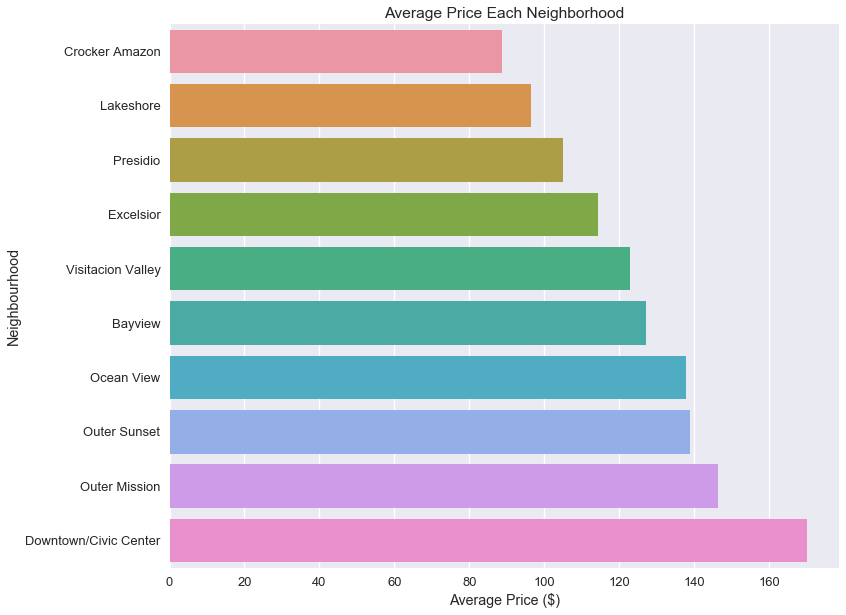

In [56]:
sns.barplot('price', 'neighbourhood_cleansed', data = price.head(10))
plt.title('Average Price Each Neighborhood')
plt.xlabel('Average Price ($)')
plt.ylabel('Neighbourhood')
plt.show()

According to above, the "cheapest" neighborhood is Crocker Amazon, which has average price of a room per day is just around 88 dollars. Area like Lakeshore, Presidio and Excelsior are all close to 100 dollars. This is way cheaper than I could imagine. District like Seacliff, is way expensive than other place, with and average price of over $ 1000.

In [81]:
count = pd.DataFrame(df.groupby('neighbourhood_cleansed')['name'].count())
count = count.sort_values(by = 'name', ascending = [0])
count.reset_index(inplace = True)
count.head(10)

,neighbourhood_cleansed,name
0,Mission,522
1,Western Addition,372
2,Castro/Upper Market,301
3,Bernal Heights,299
4,Downtown/Civic Center,288
5,South of Market,239
6,Noe Valley,239
7,Haight Ashbury,212
8,Outer Sunset,200
9,Inner Richmond,176


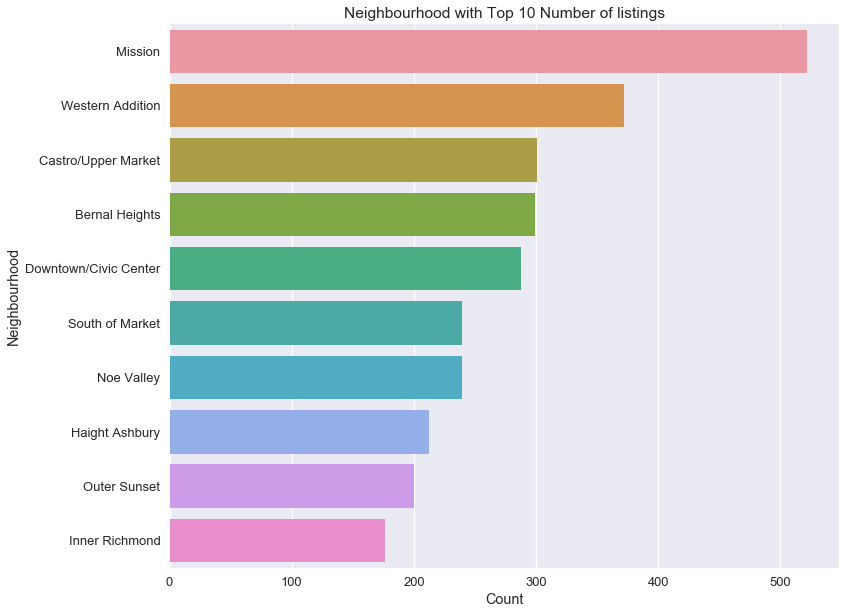

In [52]:
sns.barplot('name', 'neighbourhood_cleansed', data = count.head(10))
plt.title('Neighbourhood with Top 10 Number of listings')
plt.xlabel('Count')
plt.ylabel('Neighbourhood')
plt.show()

We could tell that neighborhood mission has the most rooms listed. Other neighborhood such as "Western Addition", "Castro/Upper Market", "Bernal Heights" and "Downtown/Civic Center" also has plenty of posting, >= 300. Compared with the graph above, we can see the only district crossed over two plot is "Downtown/Civic Center". So far, this could be the best area to find Airbnb.

### Map of Room Availablity for each Neighborhood With Marker of Car Break_ins

In [38]:
sf_n = '/Users/liliqi/Desktop/neighbourhoods.geojson'

list_loc = [[row['latitude'], row['longitude'], row['occupied_percent'], row['price'], row['neighbourhood_cleansed']] for index, row in df.iterrows()]

In [39]:
def neigh_map_making(dataframe_1, dataframe_2):
    map2 = folium.Map(location = SF_COORDINATES, zoom_start = 12)
    marker_cluster = MarkerCluster(name = "Cluster Name").add_to(map2)

    map2.choropleth(geo_data = sf_n, 
        data = dataframe_1,
        columns = ['neighbourhood_cleansed', 'name'],
        key_on = 'properties.neighbourhood', 
        fill_color = 'GnBu',
        fill_opacity = 0.85,
        line_weight = 1.2,
        legend_name = "Number of listings in a Neighbourhood")
    
    folium.Marker(
        location = my_friend,
        popup = 'My friend is here!',
        icon = folium.Icon(color = 'green', icon = 'info-sign')
    ).add_to(map2)

    folium.features.Circle(
        radius = 5000,
        location = my_friend,
        popup = "5km Circle",
        color = 'crimson',
        fill = False,
    ).add_to(map2)
    
    marker_cluster = folium.plugins.MarkerCluster(name = "car break-in layer").add_to(map2)

    for each in dataframe_2.iterrows():
        folium.Marker(location = list((each[1][2], each[1][1])), icon = folium.Icon(color = 'red', icon = 'exclamation-sign'),
                     ).add_to(marker_cluster)

    

    toggler = ScrollZoomToggler().add_to(map2) # Creates a button for enabling/disabling scroll on the Map.
    
    return(map2)

In [40]:
neigh_map_making(count, car_marker)

Here, on the map we could see that a little bit north than the central part of San Francisco has the most listing of apartments, as the color tends to be darker there than other neighborhoods. We can recognize "Mission" district pretty clear since it has the most posting. And it is even better that it is not the least safe area. Although, it still has around 3000 incidents happened. 

In [65]:
def neigh_district(dataframe_1, dataframe_2):
    map2 = folium.Map(location = SF_COORDINATES, zoom_start = 12)
    marker_cluster = MarkerCluster(name = "Cluster Name").add_to(map2)

    map2.choropleth(
        geo_data = sf_n, 
        data = dataframe_1,
        columns = ['neighbourhood_cleansed', 'name'],
        key_on = 'properties.neighbourhood', 
        fill_color = 'GnBu',
        fill_opacity = 0.9,
        line_weight = 0.6,
        legend_name = "Number of listings in a Neighbourhood")
    
    map2.choropleth(
        geo_data = district_geo, 
        data = dataframe_2, 
        columns=['PdDistrict', 'Count'], 
        key_on = 'feature.properties.district', 
        # threshold_scale = [0, 200, 300, 400, 500, 1000],
        fill_color = 'YlOrRd', 
        fill_opacity = 0.5, 
        line_opacity = 1.3, 
        legend_name = 'Number of Car Break-ins Reported Per District'
    )
    
    folium.Marker(
        location = my_friend,
        popup = 'My friend is here!',
        icon = folium.Icon(color = 'green', icon = 'info-sign')
    ).add_to(map2)

    folium.features.Circle(
        radius = 5000,
        location = my_friend,
        popup = "5km Circle",
        color = 'crimson',
        fill = False,
    ).add_to(map2)
    
    toggler = ScrollZoomToggler().add_to(map2) # Creates a button for enabling/disabling scroll on the Map.
    
    return(map2)

In [83]:
count.name = 0 - count.name # this change make the more listing the area has, the lighter the color

In [85]:
neigh_district(count, df_car_district)

Layering both the number of listing each neighborhood and count of car break-ins per pd district together. Also, on account of the change of dataframe "count". Now the ligherthe color in this plot indicates the better place to choose, since we will have more potential Airbnb post to choose and less incidents to encounter. Thus, I could choose from the south-west part of the 5km circle with the yellow-ish combined with light-green-ish color. potentially the orange-ish area as well. However, live in that part of city might have a higher chance to run into a car break-in.

In [118]:
result = """occupied_percent ~ host_response_rate + bedrooms + bathrooms 
            + host_is_superhost + host_has_profile_pic + instant_bookable 
            + cleaning_fee + security_deposit + price + number_of_reviews 
            + review_scores_location + host_identity_verified + review_scores_value"""

ols_model = smf.ols(formula = result, data = df).fit()
print (ols_model.summary())

                            OLS Regression Results                            
Dep. Variable:       occupied_percent   R-squared:                       0.070
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     25.82
Date:                Sun, 18 Mar 2018   Prob (F-statistic):           2.64e-43
Time:                        23:48:35   Log-Likelihood:                -15138.
No. Observations:                3092   AIC:                         3.030e+04
Df Residuals:                    3082   BIC:                         3.036e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept                -54

/anaconda3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1471: RuntimeWarning: divide by zero encountered in double_scalars
  return np.sqrt(eigvals[0]/eigvals[-1])
/anaconda3/lib/python3.6/site-packages/statsmodels/base/model.py:1036: RuntimeWarning: invalid value encountered in true_divide
  return self.params / self.bse
/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1821: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


We first assume that the observations are independent. The occupied percentage has a linear relationship with the predictors. We also assume that the errors in the regression model follows normal with mean 0 and constant variance.
The fitted regression is given above. The model can explain 7.0% variation in the occupied percentage according to the adjusted R-square. 

* When the host repsonse rate is increased by 1%, the occupied percentage is increased by 0.3190. 
* When the number of bathrooms is increased by 1 unit, the occupied percentage is decreased by 2.9001. 
* When the number of bedrooms is increased by 1 unit, the occupied percentage is increased by 5.0808. 
* When the chance of host is super host increased by 1%, the occupied percentage is increased by 6.897e-13.
* When the chance of host has profile picture increased by 1%, the occupied percentage is decreased by 8.935e-13.
* When the chance of the house is intantly bookable increased by 1%, the occupied percentage is decreased by 9.065e-14.
* When the review scores value is increased by 1, the occupied percentage is increased by 3.8.2062.
* When the cleaning fee is increased by 1 dollar, the occupied percentage is decreased by 0.0303. 
* When the security deposit is increased by 1 dollar, the occupied percentage is decreased by 0.0063. 
* When the price is increased by 1 dollar, the occupied percentage is increased by 0.0002. 
* When the number of reviews is increased by 1, the occupied percentage is decreased by 0.0578. 
* When the review scores location is increased by 1, the occupied percentage is increased by 0.9586. 
* When the chance of host got his identity verified increased by 1%, the occupied percentage stay the same.
* When the review scores value is increased by 1, the occupied percentage is increased by 8.2062.

As we can see, the adjusted regression is so low. It means that the model that we had is not very useful regarding to interpretating the variation in the occupied percentage. This means that we have missed some significant factor that are not in our data set. One instance, location is an major factor of for people to consider. We could not take it into consideration here in that it is a categorical variabble. It is meaningless to include such variable in a linear model. Other factor like neighbourhood will require a more advanced model to quantify the influence.

We should perform model selection like stepwise selection with AIC, for example. However, there is no exisitng code. Due to the time limitation, we cannot write the full scale model selection function. Also, the low adjusted R-square could indicate that we do not have useful predictors to explain the variation in the occupied percentage. Therefore, we should obtain more variables from different sources in order to achieve a better adjusted R-square. 